<img style="float: middle;" src="../images/logo.png">

In [1]:
from IPython.display import clear_output
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
import stlearn as st
st.settings.set_figure_params(dpi=300)
from PIL import Image, ImageChops, ImageDraw
import seaborn as sns
import SimpleITK as sitk
from skimage.color import rgb2hed
from tqdm.auto import tqdm
import anndata as ad
import seaborn as sns

In [2]:
####################
# Image Operations #
####################

def thumbnail(img, size = (1000,1000)):
    """Converts Pillow images to a different size without modifying the original image
    """
    img_thumbnail = img.copy()
    img_thumbnail.thumbnail(size)
    return img_thumbnail

class PlotImageAlignment:
    """Plot the alignment between two identically sized images
    """

    def __init__(self, style='vertical', pixel_spacing=300):
        self.px_spacing = pixel_spacing
        self.style = style

    def plot_images(self, img1, img2):
        mask = self.generate_mask(img1.size)
        overlay = img1.copy()
        overlay.paste(img2, (0, 0), mask)
        return overlay

    def generate_mask(self, img_size):
        blank_mask = Image.new('L', img_size, 0)
        if self.style == 'horizontal':
            return self.draw_horizontal_mask(blank_mask)
        elif self.style == 'vertical':
            return self.draw_vertical_mask(blank_mask)
        else:
            # Draw Tile Mask
            horizontal_mask = self.draw_horizontal_mask(blank_mask.copy())
            vertical_mask = self.draw_vertical_mask(blank_mask.copy())
            return ImageChops.difference(horizontal_mask, vertical_mask)

    def draw_horizontal_mask(self, mask):
        draw = ImageDraw.Draw(mask)
        img_width, img_height = mask.size
        x_top_left, y_top_left = 0, 0
        x_bottom_right, y_bottom_right = img_width, self.px_spacing
        while y_top_left < img_height:
            draw.rectangle((x_top_left, y_top_left, x_bottom_right, y_bottom_right), fill=255)
            y_top_left += self.px_spacing*2
            y_bottom_right += self.px_spacing*2
        return mask

    def draw_vertical_mask(self, mask):
        draw = ImageDraw.Draw(mask)
        img_width, img_height = mask.size
        x_top_left, y_top_left = 0, 0
        x_bottom_right, y_bottom_right = self.px_spacing, img_height
        while x_top_left < img_width:
            draw.rectangle((x_top_left, y_top_left, x_bottom_right, y_bottom_right), fill=255)
            x_top_left += self.px_spacing * 2
            x_bottom_right += self.px_spacing * 2
        return mask

######################
# Image Registration #
######################

def get_itk_from_pil(pil_img):
    """Converts Pillow image into ITK image
    """
    return sitk.GetImageFromArray(np.array(pil_img))

def get_pil_from_itk(itk_img):
    """Converts ITK image into Pillow Image
    """
    return Image.fromarray(sitk.GetArrayFromImage(itk_img).astype(np.uint8))

def show_alignment(fixed_img, moving_img, prefilter = None):
    """Visualises alignment of fixed image with moving image
    
    Fixed image is displayed as blue
    Moving image is displayed as pink 
    """
    if prefilter == 'TP53':
        tp53_filtered = filter_green(moving_img)
        tp53_filtered = filter_grays(tp53_filtered, tolerance = 3)
        moving_img = filter_otsu_global(tp53_filtered, 'PIL')
        he_filtered = filter_green(fixed_img)
        he_filtered = filter_grays(he_filtered, tolerance = 15)
        fixed_img = filter_otsu_global(he_filtered, 'PIL')
    background = (255,255,255)
    img_red = ImageOps.colorize(moving_img.convert('L'), (255, 0, 0), background)
    img_blue = ImageOps.colorize(fixed_img.convert('L'), (0, 0, 255), background)
    img_red.putalpha(120)
    img_blue.putalpha(70)
    return Image.alpha_composite(img_red, img_blue)

def start_plot():
    """Setup data for plotting
    
    Invoked when StartEvent happens at the beginning of registration.
    """
    global metric_values, multires_iterations
    
    metric_values = []
    multires_iterations = []

def end_plot():
    """Cleanup the data and figures 
    """
    global metric_values, multires_iterations
    
    del metric_values
    del multires_iterations
    # Close figure, we don't want to get a duplicate of the plot latter on.
    plt.close()

def update_plot(registration_method):
    """Plot metric value after each registration iteration
    
    Invoked when IterationEvent happens.
    """
    global metric_values, multires_iterations
    
    metric_values.append(registration_method.GetMetricValue())                                       
    # Clear the output area (wait=True, to reduce flickering), and plot current data
    clear_output(wait=True)
    # Plot the similarity metric values
    plt.plot(metric_values, 'r')
    plt.plot(multires_iterations, [metric_values[index] for index in multires_iterations], 'b*')
    plt.xlabel('Iteration Number', fontsize=12)
    plt.ylabel('Metric', fontsize=12)
    plt.show()
    
def update_multires_iterations():
    """Update the index in the metric values list that corresponds to a change in registration resolution
    
    Invoked when the sitkMultiResolutionIterationEvent happens.
    """
    global metric_values, multires_iterations
    multires_iterations.append(len(metric_values))
    
def plot_metric(title = 'Plot of registration metric vs iterations'):
    """Plots the mutual information over registration iterations
    
    Parameters
    ----------
    title : str
    
    Returns
    -------
    fig : matplotlib figure
    """
    global metric_values, multires_iterations
    
    fig, ax = plt.subplots()
    ax.set_title(title)
    ax.set_xlabel('Iteration Number', fontsize=12)
    ax.set_ylabel('Mutual Information Cost', fontsize=12)
    ax.plot(metric_values, 'r')
    ax.plot(multires_iterations, [metric_values[index] for index in multires_iterations], 'b*', label = 'change in resolution')
    ax.legend()
    return fig






In [3]:
def sitk_transform_rgb(moving_rgb_img, fixed_rgb_img, transform, interpolator = sitk.sitkLanczosWindowedSinc):
    """Applies a Simple ITK transform (e.g. Affine, B-spline) to an RGB image
    
    The transform is applied to each channel
    
    Parameters
    ----------
    moving_rgb_img : Pillow Image 
        This image will be transformed to produce the output image
    fixed_rgb_img : Pillow Image
        This reference image provides the output information (spacing, size, and direction) of the output image
    transform : SimpleITK transform
        Generated from image registration
    interpolator : SimpleITK interpolator
    
    Returns
    -------
    rgb_transformed : Pillow Image
        Transformed moving image 
    """
    transformed_channels = []
    r_moving, g_moving, b_moving, = moving_rgb_img.convert('RGB').split()
    r_fixed, g_fixed, b_fixed = fixed_rgb_img.convert('RGB').split()
    for moving_img, fixed_img in [(r_moving, r_fixed), (g_moving, g_fixed), (b_moving, b_fixed)]:
        moving_img_itk = get_itk_from_pil(moving_img)
        fixed_img_itk = get_itk_from_pil(fixed_img)
        transformed_img = sitk.Resample(moving_img_itk, fixed_img_itk, transform, 
                            interpolator, 0.0, moving_img_itk.GetPixelID())
        transformed_channels.append(get_pil_from_itk(transformed_img))
    rgb_transformed = Image.merge('RGB', transformed_channels)
    return rgb_transformed 

In [4]:
#########
# Paths #
#########
BASE_PATH = Path("/clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/Jaz_project")

PROCESSED_PATH = BASE_PATH / 'PROCESSED'
PROCESSED_PATH.mkdir(parents=True, exist_ok=True)

FIG_PATH = BASE_PATH / 'FIGURES'
FIG_PATH.mkdir(parents=True, exist_ok=True)

QC_PATH = FIG_PATH / "QC"
QC_PATH.mkdir(parents=True, exist_ok=True)

GENE_PLOT_PATH = FIG_PATH / "GENE_PLOT"
GENE_PLOT_PATH.mkdir(parents=True, exist_ok=True)

MARKER_PLOT_PATH = FIG_PATH / "MARKER_PLOT"
MARKER_PLOT_PATH.mkdir(parents=True, exist_ok=True)

CLUSTERING_PLOT_PATH = FIG_PATH / "CLUSTERING_PLOT"
CLUSTERING_PLOT_PATH.mkdir(parents=True, exist_ok=True)

VISIUM_PATH = BASE_PATH / "Visium_32_D1_PA21D7"
HE_PATH = VISIUM_PATH / "Slide_1_10x_A1_40pc_s4.tif"

CODEX_CELLS_PATH = PROCESSED_PATH / "S_02_8_9_CODEX.h5ad"
CODEX_IMG_PATH = BASE_PATH / "S01_2_RGB_2x.tif"

In [5]:
visium_ad = st.Read10X(VISIUM_PATH, quality="fulres",
                       image_path=HE_PATH)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


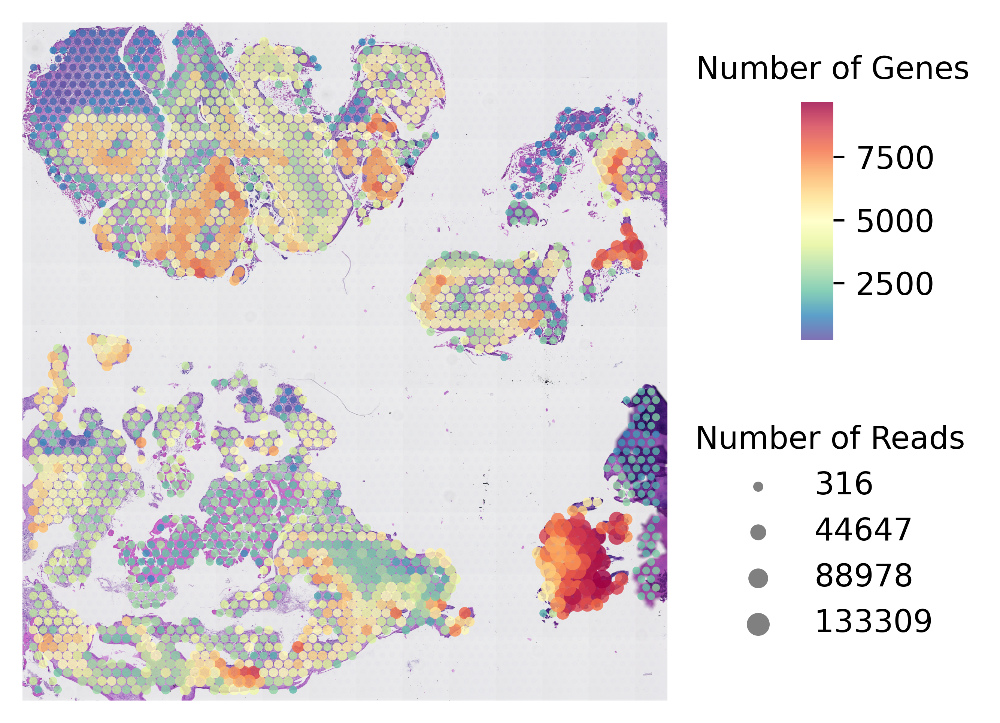

In [6]:
st.pl.QC_plot(visium_ad)

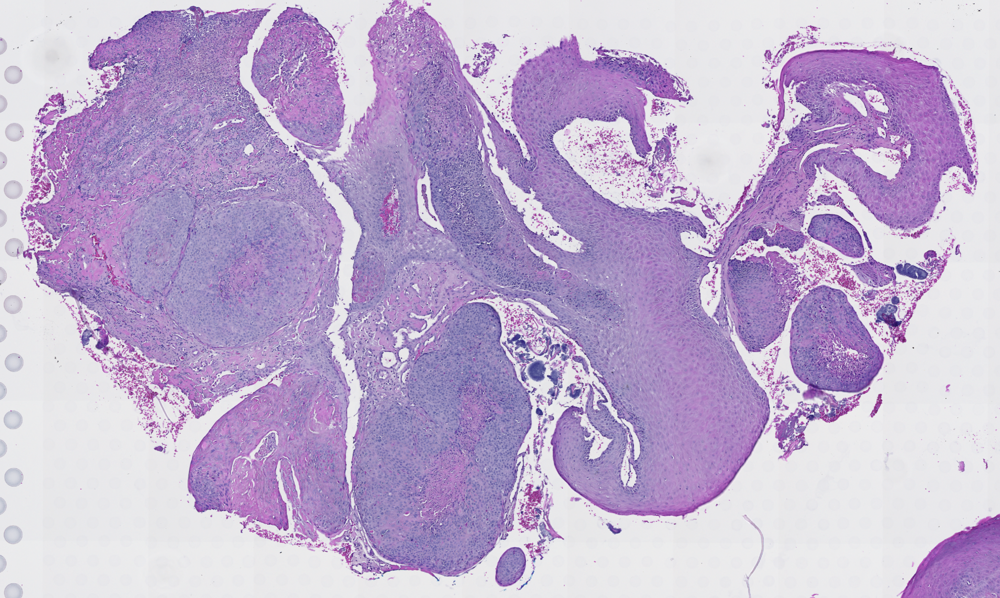

In [7]:
he_raw =  Image.open(HE_PATH).convert('RGB')
left = 400
top = 350
right = 4500
bottom = 2800
he_raw_croped = he_raw.crop((left, top, right, bottom))
thumbnail(he_raw_croped)

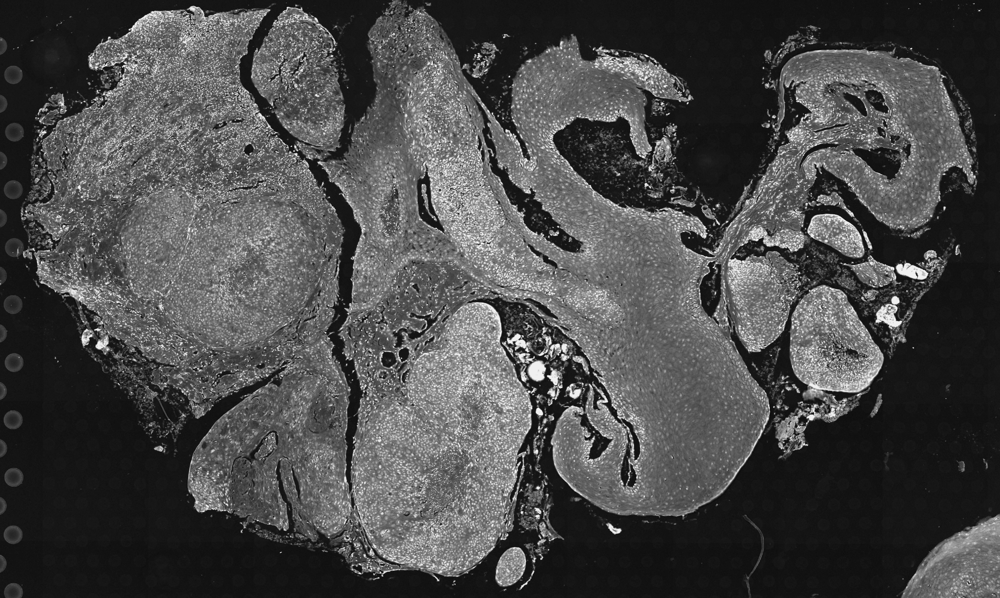

In [8]:
# Extract Haematoxylin channel from H&E 
he_hed = rgb2hed(he_raw_croped)
he_h = he_hed[:,:,0]

he_h *= 255.0 / np.percentile(he_h, q=99)
he_h = np.clip(he_h, a_min=10, a_max=240)

he_h = Image.fromarray(he_h.astype(np.uint8))
thumbnail(he_h)

In [9]:
he_h.size

(4100, 2450)

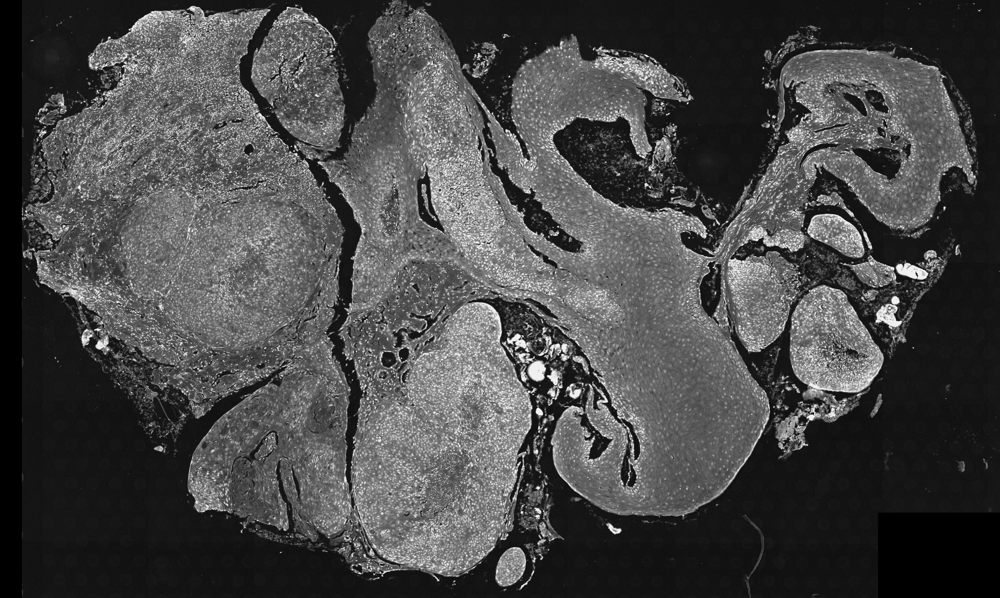

In [10]:
he_h_Array = np.array(he_h)
he_h_Array[:,0:90] = 0
he_h_Array[2100:2450, 3600:4100] = 0
he_h_clean = Image.fromarray(he_h_Array)
thumbnail(he_h_clean)

In [11]:
HE_final = he_h_clean

In [12]:
CODEX_IMG =  Image.open(CODEX_IMG_PATH).convert('L')

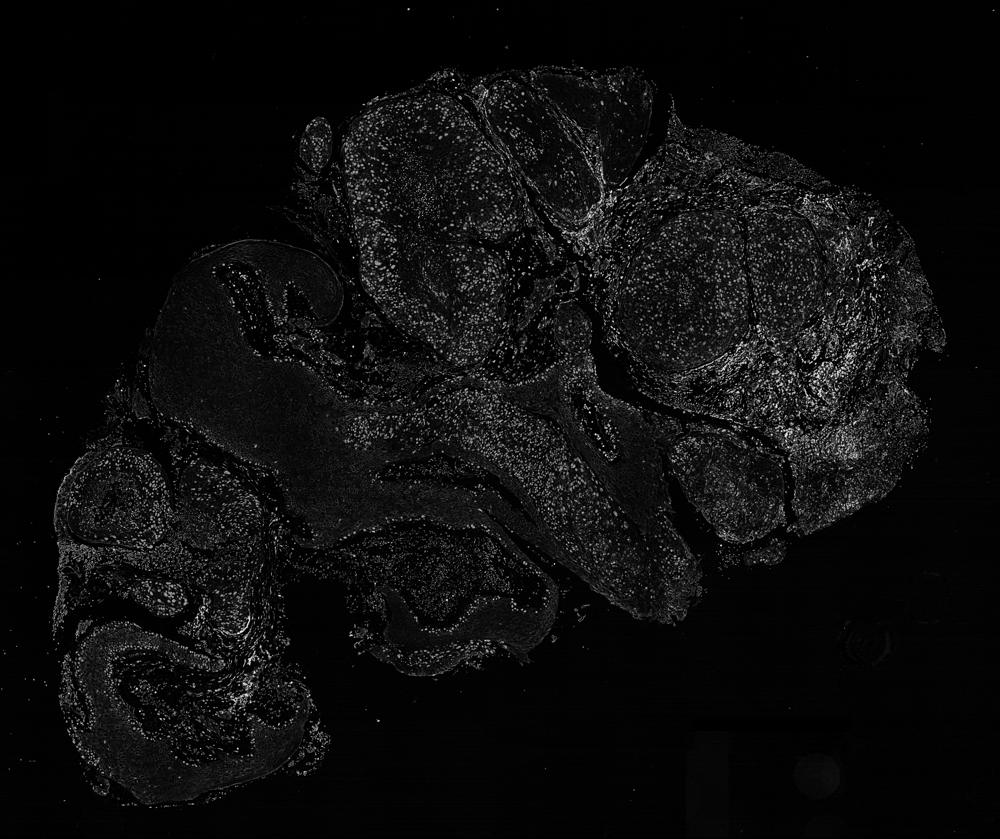

In [13]:
thumbnail(CODEX_IMG)

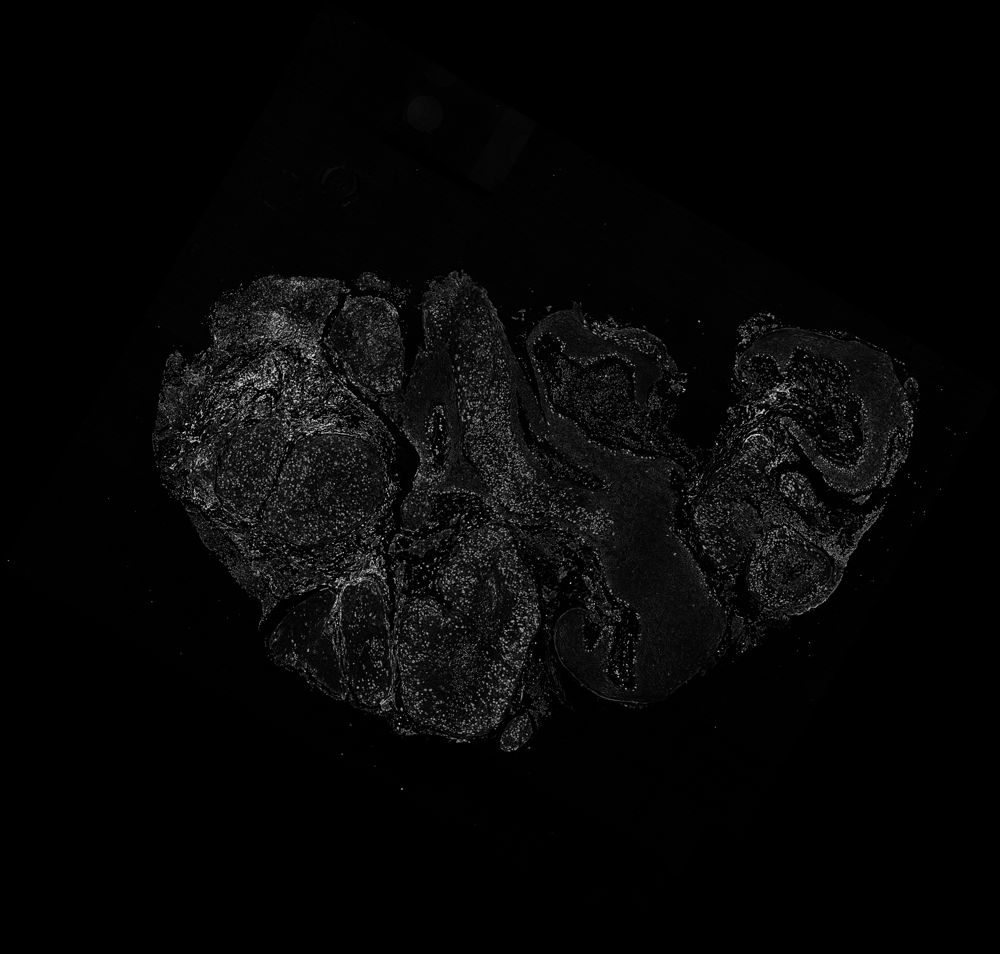

In [14]:
CODEX_IMG_rotated = CODEX_IMG.rotate(150, expand=True)
thumbnail(CODEX_IMG_rotated)

In [15]:
CODEX_IMG_rotated.size

(7282, 6948)

In [16]:
CODEX_IMG_left = 900
CODEX_IMG_top = 1900
CODEX_IMG_right = 6800
CODEX_IMG_bottom = 5600

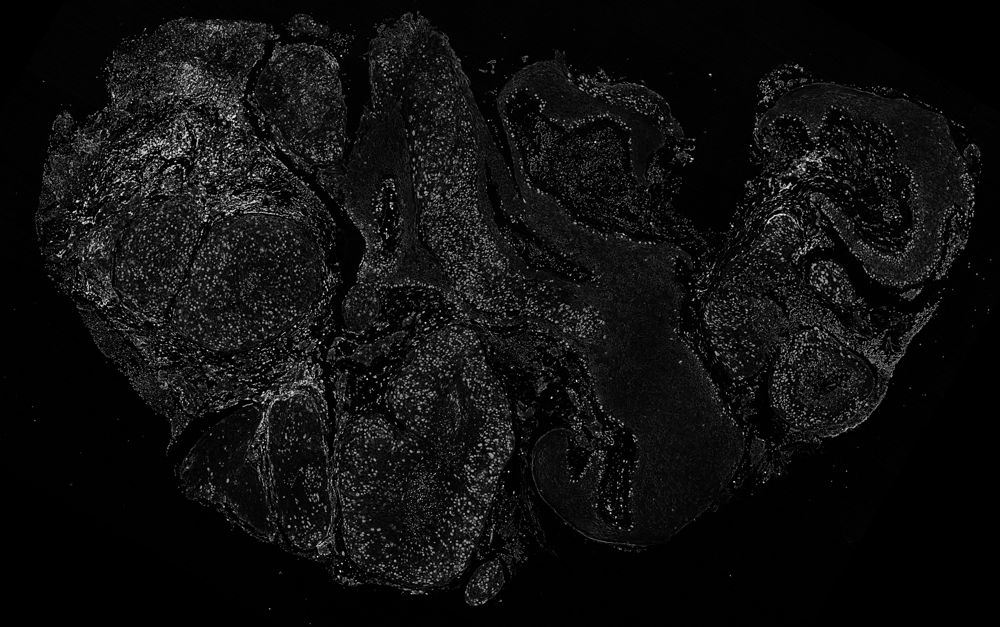

In [17]:
CODEX_IMG_rotated_crop = CODEX_IMG_rotated.crop((CODEX_IMG_left, 
                                                 CODEX_IMG_top, 
                                                 CODEX_IMG_right, 
                                                 CODEX_IMG_bottom))
thumbnail(CODEX_IMG_rotated_crop)

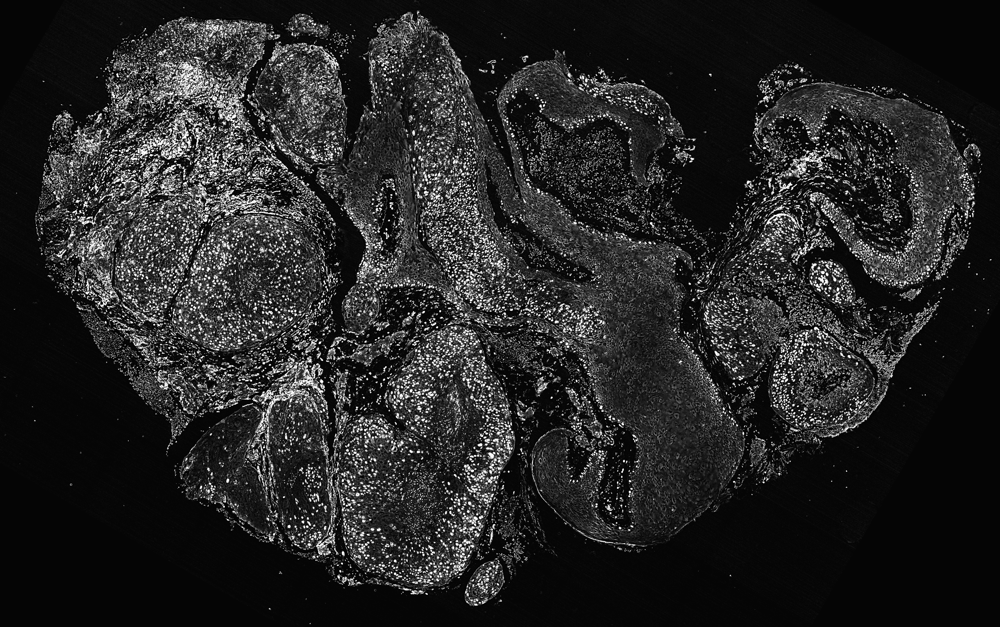

In [18]:
CODEX_IMG_rotated_crop_array = np.array(CODEX_IMG_rotated_crop).astype(np.float64)
CODEX_IMG_rotated_crop_array *= 255.0 / np.percentile(CODEX_IMG_rotated_crop_array, q=95)
CODEX_IMG_rotated_crop_array = np.clip(CODEX_IMG_rotated_crop_array, a_min=5, a_max=255)

CODEX_IMG_final = Image.fromarray(CODEX_IMG_rotated_crop_array.astype(np.uint8))
thumbnail(CODEX_IMG_final)

In [19]:
scale_factor = np.average(np.array(CODEX_IMG_final.size)/np.array(HE_final.size))
nearest_size = tuple((np.round(np.array(CODEX_IMG_final.size) / scale_factor)).astype(np.int))
CODEX_IMG_final_resize =CODEX_IMG_final.resize(size=nearest_size, resample=Image.BICUBIC)

/tmp/ipykernel_81311/1085275250.py:2: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  nearest_size = tuple((np.round(np.array(CODEX_IMG_final.size) / scale_factor)).astype(np.int))
/tmp/ipykernel_81311/1085275250.py:3: DeprecationWarning: BICUBIC is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.BICUBIC instead.
  CODEX_IMG_final_resize =CODEX_IMG_final.resize(size=nearest_size, resample=Image.BICUBIC)


In [20]:
scale_factor

1.4746142359382777

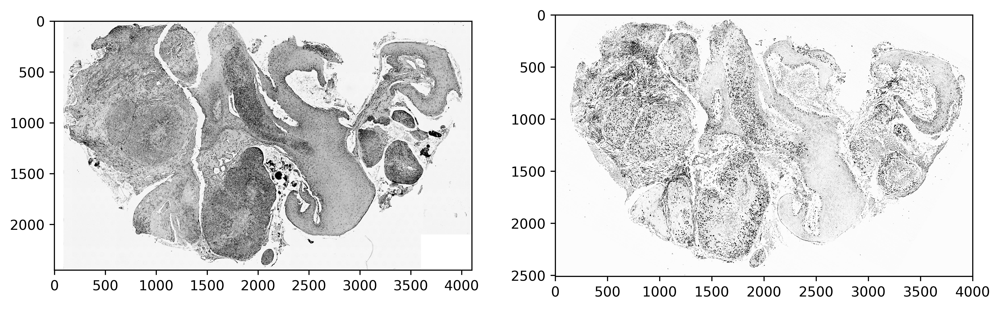

In [21]:
f, axarr = plt.subplots(1,2, figsize=(12, 12))
axarr[0].imshow(HE_final, cmap="Greys")
axarr[1].imshow(CODEX_IMG_final_resize, cmap="Greys")
plt.show()

In [22]:
segmentation = CODEX_IMG_final_resize
annotation_h = HE_final
# Convert to ITK format
segmentation_itk = get_itk_from_pil(segmentation)
annotation_itk = get_itk_from_pil(annotation_h)
# Set fixed and moving images
fixed_img = annotation_itk
moving_img = segmentation_itk

In [25]:
INTERPOLATOR = sitk.sitkLanczosWindowedSinc

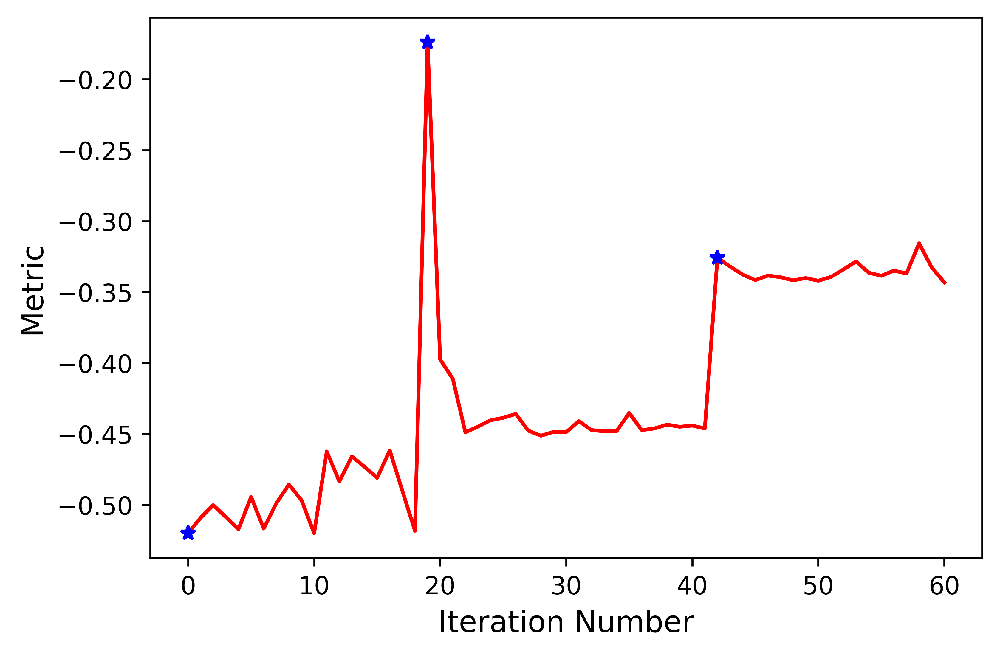

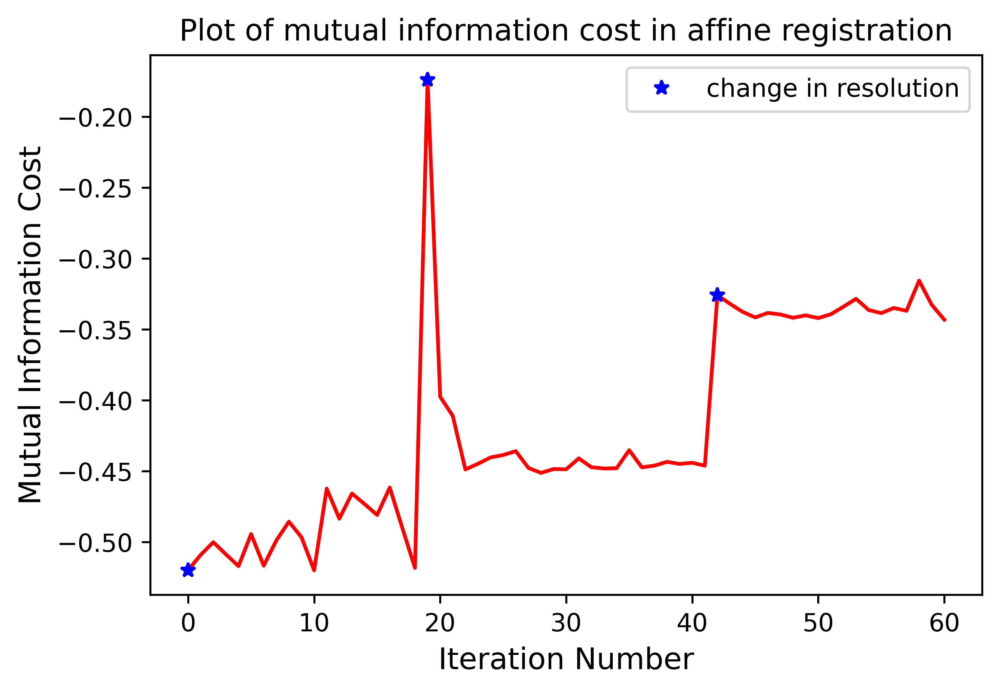

In [343]:


# --- Affine Registration --- #

initial_transform = sitk.CenteredTransformInitializer(fixed_img, moving_img, sitk.Euler2DTransform(),
                                                      sitk.CenteredTransformInitializerFilter.GEOMETRY)
affine_method = sitk.ImageRegistrationMethod()

# Similarity metric settings.
affine_method.SetMetricAsMattesMutualInformation(numberOfHistogramBins=50)
affine_method.SetMetricSamplingStrategy(affine_method.RANDOM)
affine_method.SetMetricSamplingPercentage(0.3)

affine_method.SetInterpolator(INTERPOLATOR)

# Optimizer settings.
affine_method.SetOptimizerAsGradientDescent(learningRate=0.5, numberOfIterations=100,
                                            convergenceMinimumValue=1e-6, convergenceWindowSize=20)
affine_method.SetOptimizerScalesFromPhysicalShift()

# Setup for the multi-resolution framework.
affine_method.SetShrinkFactorsPerLevel(shrinkFactors=[32,16,8])
affine_method.SetSmoothingSigmasPerLevel(smoothingSigmas=[16,8,4])
# affine_method.SetShrinkFactorsPerLevel(shrinkFactors=[64, 16])
# affine_method.SetSmoothingSigmasPerLevel(smoothingSigmas=[16, 8])
affine_method.SmoothingSigmasAreSpecifiedInPhysicalUnitsOn()

# Don't optimize in-place, we would possibly like to run this cell multiple times.
affine_method.SetInitialTransform(initial_transform, inPlace=False)

# Connect all of the observers so that we can perform plotting during registration.
affine_method.AddCommand(sitk.sitkStartEvent, start_plot)
affine_method.AddCommand(sitk.sitkMultiResolutionIterationEvent, update_multires_iterations)
affine_method.AddCommand(sitk.sitkIterationEvent, lambda: update_plot(affine_method))

affine_transform = affine_method.Execute(sitk.Cast(fixed_img, sitk.sitkFloat32),
                                         sitk.Cast(moving_img, sitk.sitkFloat32))

# affine_fig = plot_metric('Plot of mutual information cost in affine registration')
plot_metric('Plot of mutual information cost in affine registration')
plt.show()
# verbose_save_fig(affine_fig, OUTPUT_PATH.joinpath(PREFIX + 'affine_metric_plot.jpeg'))
end_plot()

# verbose_print(
#     'Affine Optimizer\'s stopping condition, {0}'.format(
#         affine_method.GetOptimizerStopConditionDescription()))

# Compute the mutual information between the two images after affine registration
moving_resampled_affine = sitk.Resample(moving_img, fixed_img, affine_transform,
                                        INTERPOLATOR, 0.0, moving_img.GetPixelID())
# affine_mutual_info = calculate_mutual_info(np.array(he_gray),
#                                            np.array(get_pil_from_itk(moving_resampled_affine)))
# verbose_print('Affine mutual information metric: {0}'.format(affine_mutual_info))
# performance_df.loc[SLIDE_NUM, "Affine_Mutual_Info"] = affine_mutual_info

In [23]:
def sitk_transform_rgb_progress(moving_rgb_img, fixed_rgb_img, transform, interpolator = sitk.sitkLanczosWindowedSinc):
    """Applies a Simple ITK transform (e.g. Affine, B-spline) to an RGB image
    
    The transform is applied to each channel
    
    Parameters
    ----------
    moving_rgb_img : Pillow Image 
        This image will be transformed to produce the output image
    fixed_rgb_img : Pillow Image
        This reference image provides the output information (spacing, size, and direction) of the output image
    transform : SimpleITK transform
        Generated from image registration
    interpolator : SimpleITK interpolator
    
    Returns
    -------
    rgb_transformed : Pillow Image
        Transformed moving image 
    """
    transformed_channels = []
    # Split RGB images into individual channels
    r_moving, g_moving, b_moving, = moving_rgb_img.convert('RGB').split()
    r_fixed, g_fixed, b_fixed = fixed_rgb_img.convert('RGB').split()
    # Resample each individual channel
    for moving_img, fixed_img in [(r_moving, r_fixed), (g_moving, g_fixed), (b_moving, b_fixed)]:
        moving_img_itk = get_itk_from_pil(moving_img)
        fixed_img_itk = get_itk_from_pil(fixed_img)
        transformed_img = resample_progress(moving_img_itk, fixed_img_itk, transform, 
                            interpolator, 0.0, moving_img_itk.GetPixelID())
        transformed_channels.append(get_pil_from_itk(transformed_img))
    rgb_transformed = Image.merge('RGB', transformed_channels)
    return rgb_transformed 

In [24]:
def resample_progress(moving_img, fixed_img, transform, interpolator, default_pixel_value, output_pixel_type):
    # Instatiate image filter and set parameter values
    resample = sitk.ResampleImageFilter()
    resample.SetReferenceImage(fixed_img)
    resample.SetTransform(transform)
    resample.SetInterpolator(interpolator)
    resample.SetDefaultPixelValue(default_pixel_value)
    resample.SetOutputPixelType(output_pixel_type)
    # Create progress bar
    pbar = tqdm(total=100)
    resample.AddCommand(sitk.sitkProgressEvent, lambda: pbar.update(100 * resample.GetProgress() - pbar.n))
    resampled_img = resample.Execute(moving_img)
    pbar.close()
    return resampled_img

In [29]:
moving_rgb_affine = sitk_transform_rgb_progress(segmentation, annotation_h, affine_transform, INTERPOLATOR)

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

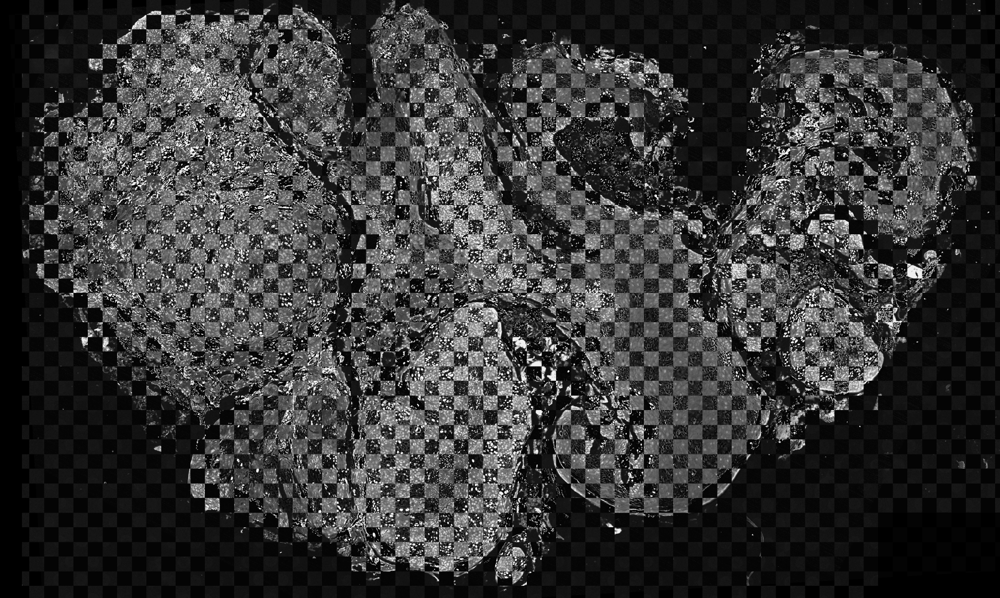

In [347]:
# Visualise and save alignment
align_plotter = PlotImageAlignment('mosaic', 60)
comparison_post_mosaic = align_plotter.plot_images(annotation_h, moving_rgb_affine)
thumbnail(comparison_post_mosaic)

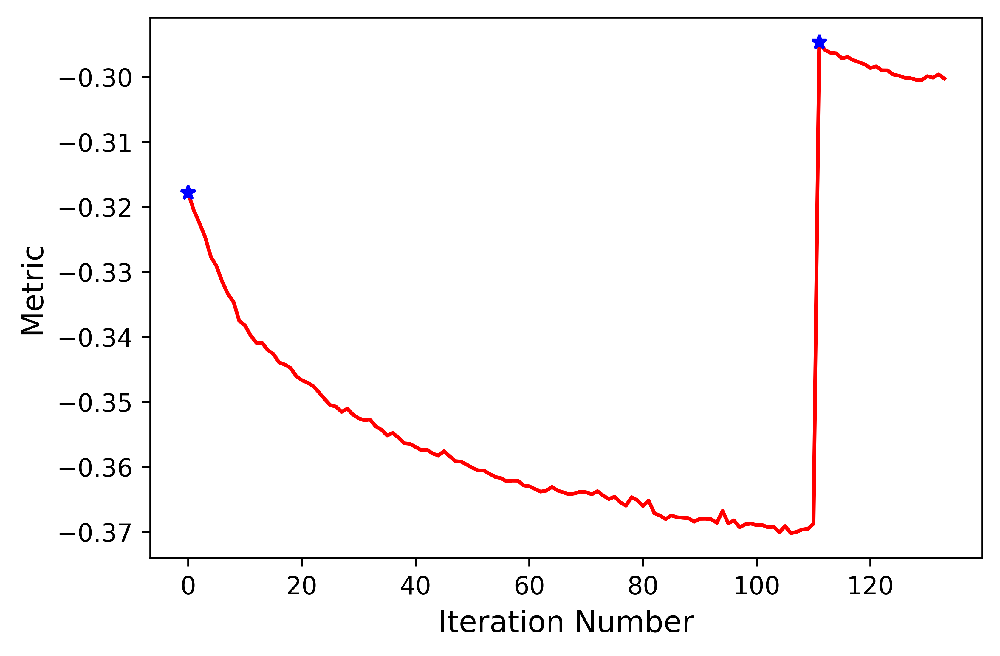

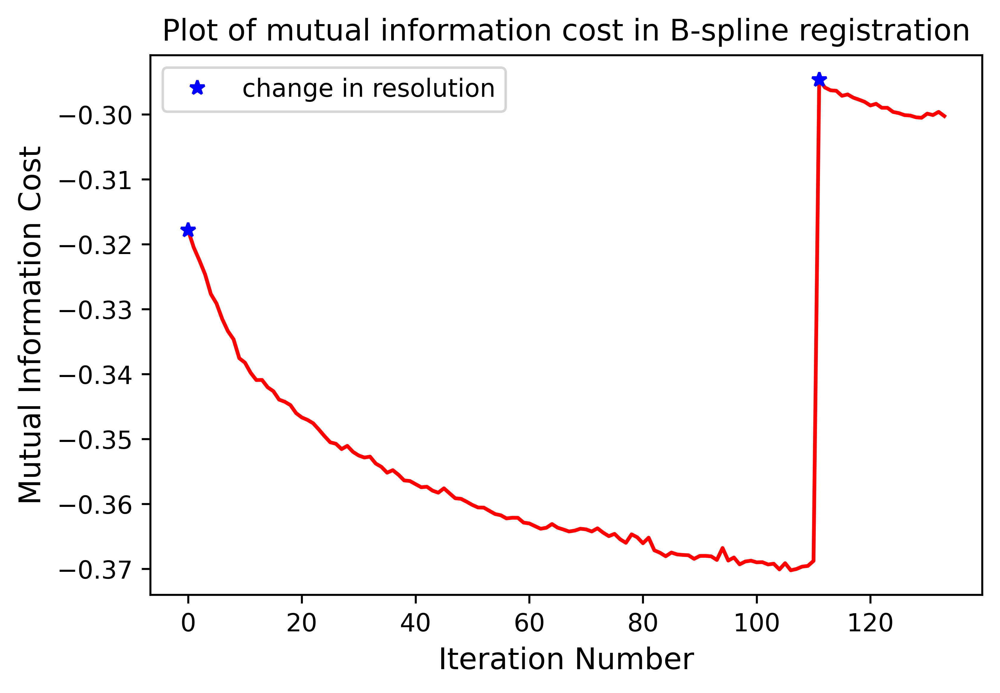

In [348]:
# --- B-spline registration --- #

bspline_method = sitk.ImageRegistrationMethod()

# Similarity metric settings.
bspline_method.SetMetricAsMattesMutualInformation(numberOfHistogramBins=50)
bspline_method.SetMetricSamplingStrategy(bspline_method.RANDOM)
bspline_method.SetMetricSamplingPercentage(0.3)

bspline_method.SetInterpolator(INTERPOLATOR)

# Optimizer settings.
bspline_method.SetOptimizerAsGradientDescent(learningRate=3, numberOfIterations=200,
                                             convergenceMinimumValue=1e-6, convergenceWindowSize=10)
bspline_method.SetOptimizerScalesFromPhysicalShift()

# Setup for the multi-resolution framework.
bspline_method.SetShrinkFactorsPerLevel(shrinkFactors=[4, 2])
bspline_method.SetSmoothingSigmasPerLevel(smoothingSigmas=[2, 1])
# bspline_method.SetShrinkFactorsPerLevel(shrinkFactors=[64, 8])
# bspline_method.SetSmoothingSigmasPerLevel(smoothingSigmas=[32, 2])
bspline_method.SmoothingSigmasAreSpecifiedInPhysicalUnitsOn()

# Don't optimize in-place, we would possibly like to run this cell multiple times.
transformDomainMeshSize = [8] * moving_resampled_affine.GetDimension()
initial_transform = sitk.BSplineTransformInitializer(fixed_img, transformDomainMeshSize)
bspline_method.SetInitialTransform(initial_transform, inPlace=False)

# Connect all of the observers so that we can perform plotting during registration.
bspline_method.AddCommand(sitk.sitkStartEvent, start_plot)
bspline_method.AddCommand(sitk.sitkMultiResolutionIterationEvent, update_multires_iterations)
bspline_method.AddCommand(sitk.sitkIterationEvent, lambda: update_plot(bspline_method))

bspline_transform = bspline_method.Execute(sitk.Cast(fixed_img, sitk.sitkFloat32),
                                           sitk.Cast(moving_resampled_affine, sitk.sitkFloat32))

# bspline_fig = plot_metric('Plot of mutual information cost in B-spline registration')
plot_metric('Plot of mutual information cost in B-spline registration')
plt.show()
# verbose_save_fig(bspline_fig, OUTPUT_PATH.joinpath(PREFIX + 'bspline_metric_plot.jpeg'))
end_plot()

# verbose_print('B-spline Optimizer\'s stopping condition, {0}'.format(
#     bspline_method.GetOptimizerStopConditionDescription()))

# Compute the mutual information between the two images after B-spline registration
moving_resampled_final = sitk.Resample(moving_resampled_affine, fixed_img, bspline_transform,
                                       INTERPOLATOR, 0.0, moving_img.GetPixelID())
# bspline_mutual_info = calculate_mutual_info(np.array(he_gray),
#                                             np.array(get_pil_from_itk(moving_resampled_final)))
# verbose_print('B-spline mutual information metric: {0}'.format(bspline_mutual_info))
# performance_df.loc[SLIDE_NUM, "Final_Mutual_Info"] = bspline_mutual_info

In [30]:
# Transform
# moving_rgb_affine = sitk_transform_rgb_progress(segmentation_transformed, annotation_h, affine_transform, INTERPOLATOR)
CODEX_aligned = sitk_transform_rgb_progress(moving_rgb_affine,HE_final, bspline_transform, INTERPOLATOR)

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

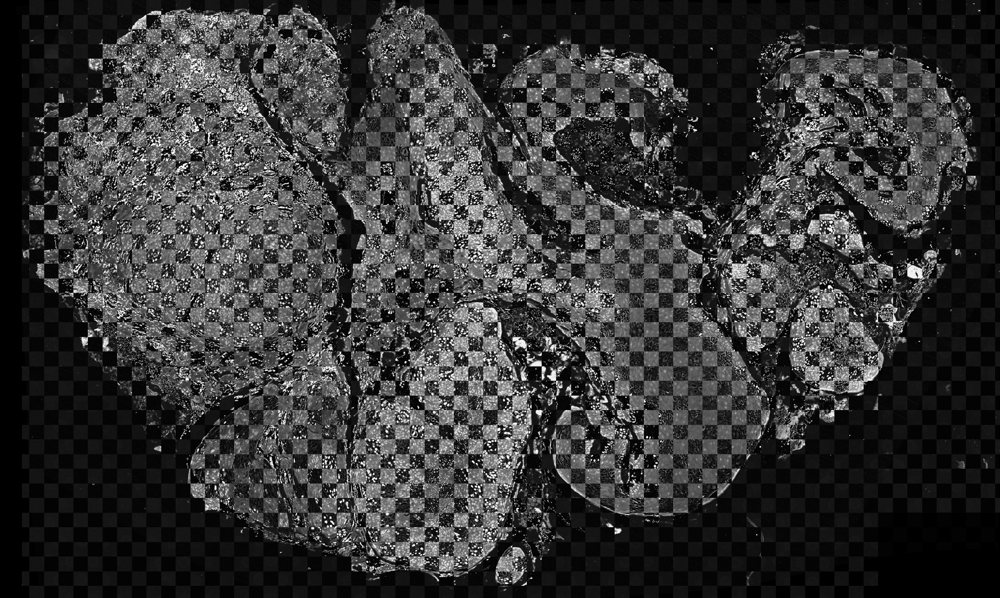

In [350]:
# Visualise and save alignment
align_plotter = PlotImageAlignment('mosaic', 60)
comparison_post_mosaic = align_plotter.plot_images(HE_final, CODEX_aligned)
# verbose_save_img(comparison_post_mosaic.convert('RGB'),
#                  OUTPUT_PATH.joinpath(PREFIX + 'comparison_post_align_mosaic.jpeg'), 'JPEG')
thumbnail(comparison_post_mosaic)

In [351]:
affine_transform_inverted = affine_transform.GetInverse()

In [352]:
fixed_img_casted = sitk.Cast(fixed_img, sitk.sitkVectorFloat64)
bspline_displacement_field = sitk.TransformToDisplacementField(bspline_transform, sitk.sitkVectorFloat64
                                                               , fixed_img_casted.GetSize()
                                                               , fixed_img_casted.GetOrigin()
                                                               , fixed_img_casted.GetSpacing()
                                                               , fixed_img_casted.GetDirection())

In [353]:
inverse_displacement_field = sitk.InverseDisplacementFieldImageFilter()
# Set output size, origin and direction to reference image
inverse_displacement_field.SetReferenceImage(bspline_displacement_field)
inverse_displacement_field.SetSize(bspline_displacement_field.GetSize())
inverse_displacement_field.SetSubsamplingFactor(128)
pbar = tqdm(total=100)
inverse_displacement_field.AddCommand(sitk.sitkProgressEvent, lambda: pbar.update(100 * inverse_displacement_field.GetProgress() - pbar.n))
b_spline_displacement_field_inverted2 = inverse_displacement_field.Execute(bspline_displacement_field)
pbar.close()

  0%|          | 0/100 [00:00<?, ?it/s]

In [354]:
bspline_transform_inverted = sitk.DisplacementFieldTransform(b_spline_displacement_field_inverted2)

In [355]:
sitk.WriteTransform(affine_transform_inverted, './S01_2_8_9_affine.tfm')
sitk.WriteTransform(bspline_transform_inverted, './S01_2_8_9_bspline.tfm')

In [26]:
affine_transform = sitk.ReadTransform('./S01_2_8_9_affine.tfm')
bspline_transform = sitk.ReadTransform('./S01_2_8_9_bspline.tfm')

In [28]:
CODEX_IMG_RGB =  Image.open(CODEX_IMG_PATH).convert('RGB')
red, green, blue = CODEX_IMG_RGB.split()
pil_list=[]
for img in [red, green, blue]:
    img_rotated = img.rotate(150, expand=True)
    img_rotated_crop = img_rotated.crop((CODEX_IMG_left, CODEX_IMG_top, 
                                         CODEX_IMG_right, CODEX_IMG_bottom))
    img_final_resize =img_rotated_crop.resize(size=nearest_size, resample=Image.BICUBIC)
    segmentation = img_final_resize
    annotation_h = HE_final
    moving_rgb_affine = sitk_transform_rgb_progress(segmentation, annotation_h, affine_transform, INTERPOLATOR)
    img_aligned = sitk_transform_rgb_progress(moving_rgb_affine, annotation_h, bspline_transform, INTERPOLATOR)
    pil_list.append(img_aligned)

/tmp/ipykernel_81311/2218651250.py:8: DeprecationWarning: BICUBIC is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.BICUBIC instead.
  img_final_resize =img_rotated_crop.resize(size=nearest_size, resample=Image.BICUBIC)


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

In [31]:
map_rgb = Image.fromarray(np.dstack([np.array(HE_final), 
                                     np.zeros((HE_final.size[1], HE_final.size[0])).astype(np.uint8),
                                     np.array(CODEX_aligned.convert("L"))]).astype(np.uint8))

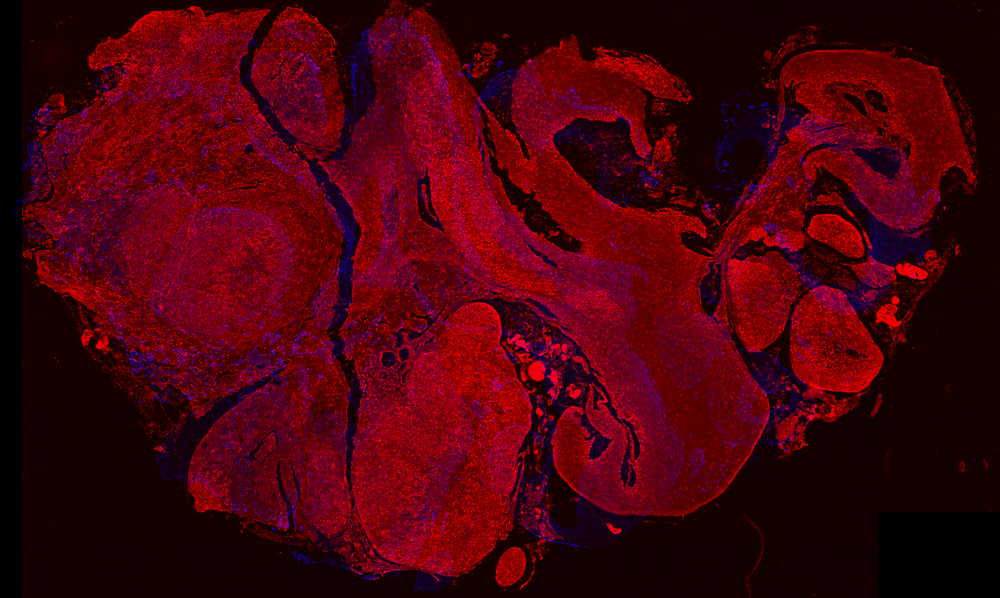

In [32]:
thumbnail(map_rgb)

In [33]:
map_rgb.save("./mapped_RGB.tiff")

In [359]:
CODEX_rgb = Image.fromarray(np.dstack([np.array(i.convert("L")) for i in pil_list]
                                  ).astype(np.uint8))

In [1]:
# thumbnail(CODEX_rgb)

In [361]:
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
import matplotlib.pyplot as plt
import numpy as np

/tmp/ipykernel_50962/1140715101.py:5: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = fig.gca(projection='3d')
/tmp/ipykernel_50962/1140715101.py:12: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.axes.set_zticklabels(["    H&E", "    CODEX"])


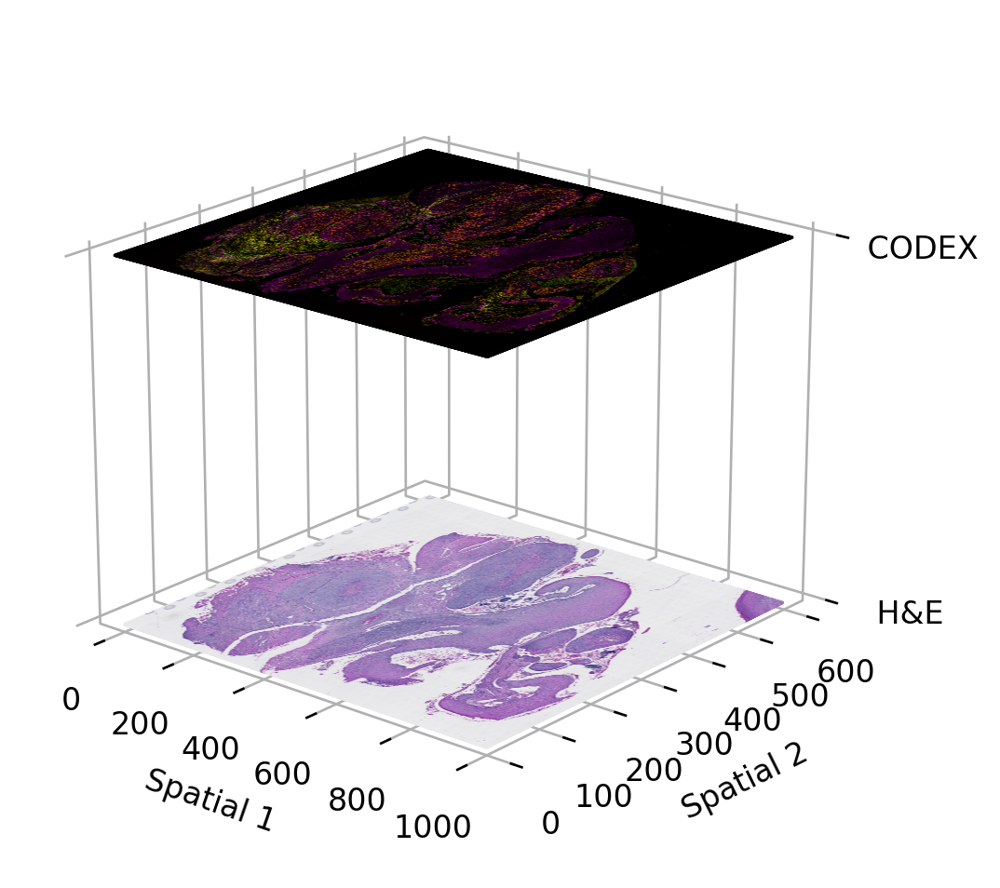

In [362]:
layer_1 = thumbnail(he_raw_croped)
layer_2 = thumbnail(CODEX_rgb)

fig = plt.figure(figsize=(8, 5), dpi=120)
ax = fig.gca(projection='3d')
# sc_points = ax.scatter(df_3d["mapped_x"], df_3d["mapped_y"], df_3d["z"], 
#                   cmap="tab10", c=df_3d["clusters"])
ax.set_zlim(0, 1)
# ax.set_axis_off()
ax.zaxis.set_major_locator(LinearLocator(2))
# plt.zticks(range(3),["H&E", "CODEX", "VISIUM"])
ax.axes.set_zticklabels(["    H&E", "    CODEX"])
# X1 = np.arange(0, np.array(he_raw_rotated_LN2).shape[0], 100)
# Y1 = np.arange(0, np.array(he_raw_rotated_LN2).shape[1], 100)
# X1, Y1 = np.meshgrid(X1,
#                      Y1)
# plt.gca().invert_yaxis()
ax.w_xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
ax.w_yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
ax.w_zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))

ax.w_xaxis.line.set_color((1.0, 1.0, 1.0, 0.0))
ax.w_yaxis.line.set_color((1.0, 1.0, 1.0, 0.0))
ax.w_zaxis.line.set_color((1.0, 1.0, 1.0, 0.0))

# ax.set_xticks([]) 
# ax.set_yticks([])
# ax.set_zticks([])

ax.set_xlabel('Spatial 1' )
ax.set_ylabel('Spatial 2')
# ax.set_zlabel('Datasets')

X1, Y1 = np.mgrid[0:np.array(layer_1).shape[0],
                     0:np.array(layer_1).shape[1]]

ax.plot_surface(Y1, X1, np.array([[0]]), rstride=1, cstride=1, facecolors=np.array(layer_1)/255,
               shade=False)

X2, Y2 = np.mgrid[0:np.array(layer_2).shape[0],
                     0:np.array(layer_2).shape[1]]

ax.plot_surface(Y2, X2, np.array([[1]]), rstride=1, cstride=1, facecolors=np.array(layer_2)/255,
               shade=False)

ax.view_init(20, -50)

plt.show()

In [364]:
affine_S02 = sitk.ReadTransform('./S01_2_8_9_affine.tfm')
bspline_S02 = sitk.ReadTransform('./S01_2_8_9_bspline.tfm')

In [365]:
CODEX_ad = ad.read_h5ad(CODEX_CELLS_PATH)

In [366]:
x_coor = CODEX_ad.obs["Centroid X µm"] / 0.3774 / 2
y_coor = CODEX_ad.obs["Centroid Y µm"] / 0.3774 / 2

In [2]:
# fig, axs = plt.subplots(figsize=(15,15))
# axs = sns.scatterplot(x=x_coor, alpha=0.8, s=1,
#                         y=y_coor)
# plt.imshow(CODEX_IMG, origin='lower')
# plt.gca().invert_yaxis()
# plt.show()

In [368]:
import cv2
def rotate_point(point, cx, cy, h, w, theta):
    # opencv calculates standard transformation matrix
    M = cv2.getRotationMatrix2D((cx, cy), theta, 1.0)
    # Grab  the rotation components of the matrix)
    cos = np.abs(M[0, 0])
    sin = np.abs(M[0, 1])
    # compute the new bounding dimensions of the image
    nW = int((h * sin) + (w * cos))
    nH = int((h * cos) + (w * sin))
    # adjust the rotation matrix to take into account translation
    M[0, 2] += (nW / 2) - cx
    M[1, 2] += (nH / 2) - cy
    # Prepare the vector to be transformed
    v = [point[0],point[1],1]
    # Perform the actual rotation and return the image
    calculated = np.dot(M,v)
    return calculated[0],calculated[1]

In [369]:
(heigth, width) = np.array(CODEX_IMG).shape[:2]
(cx, cy) = (width // 2, heigth // 2)

In [370]:
x_new_ls = []
y_new_ls = []
for x,y in zip(x_coor, y_coor):
    x_new,y_new = rotate_point([x,y], cx, cy, heigth, width, 150)
    x_new_ls.append(x_new)
    y_new_ls.append(y_new)

In [371]:
x_new_crop_ls = []
y_new_crop_ls = []

for x,y in zip(x_new_ls, y_new_ls):
    if x<CODEX_IMG_left or x>CODEX_IMG_right:
        x_=y_=-1
    elif y<CODEX_IMG_top or y>CODEX_IMG_bottom:
        x_=y_=-1
    else:
        x_ = x-CODEX_IMG_left
        y_ = y-CODEX_IMG_top
    x_new_crop_ls.append(x_)
    y_new_crop_ls.append(y_)

In [3]:
# fig, axs = plt.subplots(figsize=(15,15))
# axs = sns.scatterplot(x=x_new_crop_ls, alpha=0.8, s=1,
#                         y=y_new_crop_ls)
# plt.imshow(CODEX_IMG_final, origin='lower')
# plt.gca().invert_yaxis()
# plt.show()

In [373]:
x_coor_final = x_new_crop_ls / scale_factor
y_coor_fianl = y_new_crop_ls / scale_factor

In [374]:
points_affine = [affine_S02.TransformPoint((int(x), int(y))) 
                 for x, y in zip(x_coor_final, y_coor_fianl)]
points_bspline = [bspline_S02.TransformPoint((int(x), int(y))) 
                 for x, y in points_affine]

In [4]:
# fig, axs = plt.subplots(figsize=(15,15))
# axs = sns.scatterplot(x=[x for x,y in points_bspline], alpha=1, s=1,
#                         y=[y for x,y in points_bspline])
# plt.imshow(CODEX_aligned, origin='lower')
# plt.gca().invert_yaxis()
# plt.show()

In [376]:
CODEX_ad.obs["X_new"] = [x for x,y in points_bspline]
CODEX_ad.obs["Y_new"] = [y for x,y in points_bspline]

In [377]:
visium_x = visium_ad.obs["imagecol"]
visium_y = visium_ad.obs["imagerow"]

x_new_ls = []
y_new_ls = []

for x,y in zip(visium_x, visium_y):
    if x<left or x>right:
        x_=y_=-1
    elif y<top or y>right:
        x_=y_=-1
    else:
        x_ = x-left
        y_ = y-top
    x_new_ls.append(x_)
    y_new_ls.append(y_)

In [378]:
visium_ad.obs["mapped_x"] = x_new_ls
visium_ad.obs["mapped_y"] = y_new_ls

In [379]:
# visium_ad.obs["imagerow"] = visium_ad.obs["mapped_x"]
# visium_ad.obs["imagecol"] = visium_ad.obs["mapped_y"] 

In [419]:
from sklearn.linear_model import LinearRegression
from scipy.spatial import cKDTree

def convert_codex_to_visium_like_adata(visium_adata, codex_adata, library_id, img):
    dis = abs(LinearRegression().fit(visium_adata.obs["array_col"].values.reshape(-1, 1), 
                       visium_adata.obs["imagecol"].values.reshape(-1, 1)).coef_.item())
    radius = 2* dis * (55/100) / 2
    btree = cKDTree(codex_adata.obs[["X_new", "Y_new"]])
    v_points = btree.query_ball_point(visium_adata.obs[["mapped_x", "mapped_y"]], radius)
    codex_mtx = codex_adata.to_df().reset_index()
    codex_mtx["Visium_spot"] = "Not_assigned"
    for i, codex_index in enumerate(v_points):
        codex_mtx.loc[codex_index, "Visium_spot"] = visium_adata.obs_names[i]
    codex_mtx = codex_mtx.set_index(["index","Visium_spot"])
    codex_mtx = codex_mtx.groupby(level="Visium_spot", axis=0).mean()
    common_spots = codex_mtx[codex_mtx.index.isin(visium_adata.obs_names)].index
    codex_mtx = codex_mtx.loc[common_spots,:]
    codex_obs = visium_adata.obs.loc[common_spots,:]
    codex_obs["imagerow"] = codex_obs["mapped_y"]
    codex_obs["imagecol"] = codex_obs["mapped_x"]
    
    adata = ad.AnnData(X=codex_mtx,
                        obs=codex_obs)
    
    adata.uns = dict()
    adata.uns["spatial"] = dict()
    adata.uns["spatial"][library_id] = dict()
    adata.uns["spatial"][library_id]["images"] = dict()
    adata.uns["spatial"][library_id]["images"]["fulres"] = np.array(img)
    adata.uns["spatial"][library_id]["use_quality"] = "fulres"
    adata.uns["spatial"][library_id]['scalefactors'] = dict()
    adata.uns["spatial"][library_id]['scalefactors']["tissue_fulres_scalef"] = 1
    adata.uns["spatial"][library_id]['scalefactors']["tissue_hires_scalef"] = 1
    adata.uns["spatial"][library_id]['scalefactors']["spot_diameter_fulres"] = 10
    adata.obsm["spatial"] = adata.obs[["imagecol", "imagerow"]].values
    
    return adata

In [422]:
library_id = "S02"
codex_v = convert_codex_to_visium_like_adata(visium_ad, CODEX_ad, 
                                             library_id, he_raw_croped)

In [423]:
# for i in codex_v.var_names:
    
#     print(i)
#     try:
#         gene_plot(visium_ad_, genes=i, spot_size=20)
#         plt.show()
#     except:
#         continue

In [6]:
# # for i in codex_v.var_names:
# #     print(i)
# #     gene_plot(codex_v, genes=i)
# #     plt.show()
# for i in codex_v.var_names:
#     print(i)
#     gene_plot(codex_v, genes=i, spot_size=20,
# #               output=str(MARKER_PLOT_PATH), name="mapped_CODEX_spot_{}.png".format(i)
#              )
#     plt.show()

In [5]:
# for i in codex_v.var_names:
#     print(i)
#     gene_plot(CODEX_ad, genes=i, spot_size=0.3,
# #               output=str(MARKER_PLOT_PATH), name="mapped_CODEX_single_cell_{}.png".format(i)
#              )
#     plt.show()

In [391]:
common_spots = codex_v.obs_names.intersection(visium_ad.obs_names)

In [394]:
visium_ad_ = visium_ad[common_spots]

In [427]:
codex_v.write_h5ad(PROCESSED_PATH / "S_02_8_9_CODEX_Visium_spots.h5ad")

In [396]:
visium_ad_.write_h5ad(PROCESSED_PATH / "S_02_8_9_Visium_new_coor.h5ad")

In [428]:
CODEX_ad.write_h5ad(PROCESSED_PATH / "S_02_8_9_CODEX_mapped.h5ad")